**Lab 6: IIR Filtering**


The objective for this lab is to build an intuitive understanding of the relationship between the location
of poles and zeros in the z-domain, the impulse response h[n] in the n-domain, and the frequency
response $H(e^{j\omega})$. We use the system function,
represented as a ratio of polynomials in $z^{-1}$, which can be expressed in either factored or expanded form as:

$$
H(z) = G\frac{\prod_{k=1}^M (1-z_kz^{-1}) }{\prod_{k=1}^N (1-p_kz^{-1})} = \frac{ \sum_{k=0}^M b_kz^{-k}}{ 1- \sum_{k=1}^N a_kz^{-k} }
$$

In [ ]:
!git clone https://github.com/pzinemanas/sis1lab.git

import numpy as np
import IPython.display as ipd
from scipy import signal
import matplotlib.pyplot as plt
from IPython.display import Audio

from sis1lab.util import load_audio, plot_signals, plot_spectrogram, plot_frequency_response

Cloning into 'sis1lab'...
remote: Enumerating objects: 59, done.
remote: Counting objects: 100% (59/59), done.
remote: Compressing objects: 100% (43/43), done.
remote: Total 59 (delta 16), reused 28 (delta 6), pack-reused 0
Unpacking objects: 100% (59/59), done.


KeyboardInterrupt: ignored

In [ ]:
# Loading reference audio
!git clone https://github.com/Alejandro-FA/sis1_group0.git
filepath = "./sis1_group0/resources/Mandolin_Tuner.wav"
ref, fs = load_audio(filepath)

Cloning into 'sis1_group0'...
remote: Enumerating objects: 76, done.
remote: Counting objects: 100% (76/76), done.
remote: Compressing objects: 100% (62/62), done.
remote: Total 76 (delta 28), reused 23 (delta 8), pack-reused 0
Unpacking objects: 100% (76/76), done.


**1. IIR filters to extract the envelope**

In the previous labs, you extracted the envelope from your reference signal by applying the following system:

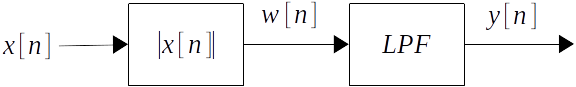

where $w[n] = |x[n]|$ and $y[n]$ was the output of a low-pass FIR filter (averaging filter). In this exercise, you will re-implement this low-pass filter as an IIR.

1.1 First, copy the functions envelope and synthesize from previous work and obtain the same synthesis. 



In [ ]:
# Define envolope and synthesize functions
def averaging_filter(x, N, mode):
  b = np.array([1.0/N]*N)
  y = np.convolve(b, x, mode=mode)
  
  return y

def envelope(x, N):
  x_rect = np.abs(x)
  y = averaging_filter(x_rect, N, 'same')

  return y

def synthesize(f0, phi, Ak, t):
  y = 0
  for k in range(1, len(Ak) + 1):
    y += Ak[k-1] * np.cos(2*np.pi*k*f0*t + k*phi - (k-1)*np.pi/2)
  return y

# Compute envelope
N = 500;
env = envelope(ref, N)

# Compute synthesized signal
weights = [1, 0.5196, 0.3379, 0.7774, 0.2000, 0.1077, 0.8555, 0.01760, 0.1553, 
           0.0467, 0.0625, 0.00736, 0.00730, 0.0096, 0.01677, 0.0026, 0.0039,
           0.0014, 0.0014, 0.000999, 0.0000887, 0.00256, 0.0000869, 0.0000536
           , 0.0000513, 0.0000757, 0.0000226, 0.0000362, 0.0000203, 0.0000407
           , 0.0000268, 0.0000511, 0.00903]

Ts = 1/float(fs)
t = np.arange(0, len(env)*Ts, Ts)
f_0 = 296.08
dt = 1.004338 - 1.003 #Data from Lab 2
phi = -np.pi*f_0*2*dt  #Data from Lab 2

synth_signal = synthesize(f_0, phi, weights, t)

# Apply envelope to synthesized signal (as in the previous lab)
synth_env = env*synth_signal

1.2 Let's take a look at the following system:

$$
H(z) = G\frac{1+z^{-1}}{1-rz^{-1}} \quad   0<r<1 \quad, G = \frac{1-r}{2}
$$

Note that the coefficients of the filter are the following:

$$
b_0 = 1, \quad b_1 = 1, \quad a_0 = 1, \quad a_1 = -r, \quad
$$

**i. Find the zeros and poles of the system analytically.**

$$H(z) = \frac{1-r}{2}·\frac{1+z^{-1}}{1-rz^{-1}} = \frac{1+z^{-1}-r-rz^{-1}}{2-2rz^{-1}} \stackrel{·\frac{z^1}{z^1}}{=}\frac{z+1-rz-r}{2z-2r}= \frac{z(1-r)+1-r}{2z-2r} $$
In order to find the zeroes we find the solutions of the nominator as follows: 
$$  z(1-r)+1-r = 0 \to z = \frac{-1+r}{1-r}= \frac{-(-1+r)}{-1+r}=-1 $$
In order to fins the poles, we solve for z the denominator:    
$$2z-2r = 0 \to z = r $$


**ii. Use the function `np.roots` to find the zeros and poles using Python. Compare the results with part i.**

In [ ]:
# Zeroes
r = 0.9
coeff_zeroes = [(1-r),(1-r)]
z = np.roots(coeff_zeroes)

#Poles 
coeff_poles = [2,-2*r]
p = np.roots(coeff_poles)

**iii. Use the function  `plot_zeros_poles(z, p)` to plot the zeros and poles found in ii.**

In [ ]:
from sis1lab.util import plot_zeros_poles

plot_zeros_poles(z,p)
# Write your code here

**1.3 Let's see the frequency response of this filter:**



In [ ]:
ww = np.arange(-np.pi, np.pi, np.pi/500)
r = 0.9
G = (1 - r)/2
_, HH = signal.freqz([G, G], [1 , -r], ww)

plot_frequency_response(ww, HH)

1.4. Change the parameter $r$ in the range $(0, 1)$. What happens when $r$ is increased?

When $r$ is increased the system becomes less stable, since the pole is closer to the unit circle. As a consquence, if we take a look at the frequency response, the peak at $ \hat{w} = 0$ becomes more pronunciated. 

1.5 What type of filter is (low-pass, band-pass, or high-pass filter)?


It is a low-pass filter which can be easily seen from the frequency response plot. 

1.6 Now we can use this IIR filter to extract the envelope. Let's define a new function `envelope_iir(x)` that applies the filter to the absolute value of the signal. Note that we are using signal.lfilter function to apply the filter.


In [ ]:
def envelope_iir(x, r=0.995):
  G = (1 - r)/2
  y = signal.lfilter([G, G], [1, -r], np.abs(x))
  return y

Extract the envelope of your reference signal using both the FIR and IIR filters and compare the results plot them along with the signal. Change the value of $r$ until you are comfortable with the result.

In [ ]:
env_iir = envelope_iir(ref, 0.995)

plot_signals([ref, env, env_iir], fs, name=['reference', 'envelope fir', 'envelope iir'], mode='lines')

Increasing the value of $r$ is equvalent to increasing the value of $N$ in the n-averaging filter used to extract the envelope.

1.7 What are the main differences between the two filters? For instance, compare the number of coefficients.

The number of coefficients is much higher in the FIR filter (N coefficients, in our case 500). On the other hand, the IIR filter only has three coefficents, of which two of them are FIR and one IIR. 

As we know from theory, the convolution of the reference signal and the FIR envelope will be finite. While with the IIR, the convolution will be infinite.

1.8 Apply the new envelope (extracted from the IIR filter) to the synthesis generated with the `synthesize` function and listen to the result.

In [ ]:
# Write your code here
synth_env = env_iir*synth_signal

In [ ]:

# Reference signal audio (for comparison purposes)
Audio(np.real(ref), rate=fs)

In [ ]:
# Signal with IIR envelope applied
Audio(np.real(synth_env), rate=fs)

The result is practically identical to the one of Lab 4, which is to be expected since the envelope is very similar.

---

**2. Band-pass filters**

Now let's work with the following system: 

$$
H(z) = \frac{(1-z^{-1})(1+z^{-1})}{(1-re^{j\omega_n}z^{-1})(1-re^{-j\omega_n}z^{-1})}, \quad 0<r<1
$$

Note that the poles are $p_1 = re^{j\omega_n}$ and $p_2 = re^{-j\omega_n}$; and the zeros are $z_1=1$ and $z_2=-1$. 

2.1 Use the function `plot_zeros_poles` to plot the zeros and poles of the system.

Note: use $w_n = \pi/4$ and $r=0.99$.

In [ ]:
# Write your code here
# Zeroes
r = 0.99
b_k = [1,0,-1] 
z = np.roots(coeff_zeroes)

#Poles 
wn = np.pi/4
a_k = [1,-2*r*np.cos(wn), r**2]
p = np.roots(coeff_poles)

plot_zeros_poles(z,p)

2.2 Show analytically that $a_k = [1, -2rcos(\omega_n), r^2]$ and $b_k=[1, 0, -1]$.

$$H(z) = \frac{(1-z^{-1})(1+z^{-1})}{(1-re^{j\omega_n}z^{-1})(1-re^{-j\omega_n}z^{-1})}= \frac{1-z^{-2}}{1-re^{jw_n}z^{-1}-re^{-jw_n}z^{-1}+r^2z^{-2}} = \frac{1-z^{-2}}{1-z^{-1}·(re^{jw_n}+re^{-jw_n})+r^2z^{-2}}=\frac{1-z^{-2}}{1-z^{-1}·2r\cos(w_n)+r^2z^{-2}} \\ \frac{1-z^{-2}}{1-z^{-1}·2r\cos(w_n)+r^2z^{-2}} \stackrel{·\frac{z^2}{z^2}}{=} \frac{z^2-1}{z^2-z·2r\cos(w_n)+r^2}   $$

From here we can see that the coefficients are the ones from the statement ($b_k$ are the coefficients of the numerator and $a_k$ are the coefficients of the denominator). 

2.3 Plot the frequency response of the filter. Confirm this is a band-pass filter. What's the central frequency of the passband?

In [ ]:
ww = np.arange(-np.pi, np.pi, np.pi/500)
G = (1 - r)/2
_, HH = signal.freqz(b_k, a_k, ww)

plot_frequency_response(ww, HH)

It is a bandpass filter because the 0 frequency and high frequencies are attenuated but the magnitudes around $\hat{w} = \pi / 4$ are amplified. 


2.4 Define a function `bpf(x, f, r, fs)` that applies the above band-pass filter. 

Note 1: remember that a frequency can be converted to the normalized radian frequncy by: $\omega_n = 2\pi f_n/f_s$.

Note 2: use `signal.lfilter` function to implement the filter.

In [ ]:
def bpf(x, fn, fs, r=0.995):
  """Applies a band-pass filter with central frequency fn

  Parameters
  ----------
  x : np.array
      The input signal in the form of a numpy array
  fn: int or float
      Central frequency of the band pass in Hz 
  fs : int or float
      Frequency rate in Hz
  r: float
      Magnitude of the poles

  Returns
  -------
  y : np.array
      The output of the filter

  """
  wn = 2*np.pi*fn/fs
  b_k = [1,0,1]
  a_k = [1,-2*r*np.cos(wn), r**2]
  y = signal.lfilter(b_k, a_k, x)
  return y

2.5 Regardless of the phase, until now we were synthesizing the instrument signal by summing $K$ harmonics of the signal with different weights ($A_k$) and multiplying the sum by the envelope of the reference signal ($e(t)$):

$$y(t) = e(t) \cdot \sum_{k=1}^K A_k\cos\left(2\pi kf_0 t \right), $$

where $f_0$ is the fundamental frequency of the note. Now we want to improve this synthesis by finding a time-dependent amplitude ($A_k(t)$) for each harmonic:

$$y(t) = \sum_{k=1}^K A_k(t) \cos\left(2\pi kf_0 t \right), $$

where $A_k(t)$ is the amplitude of the harmonic $k$. To extract the amplitudes $A_k(t)$ we'll apply a band-pass filter with central frequency $kf_0$ and calculate the envelope of the output by using the `envelope_iir`.


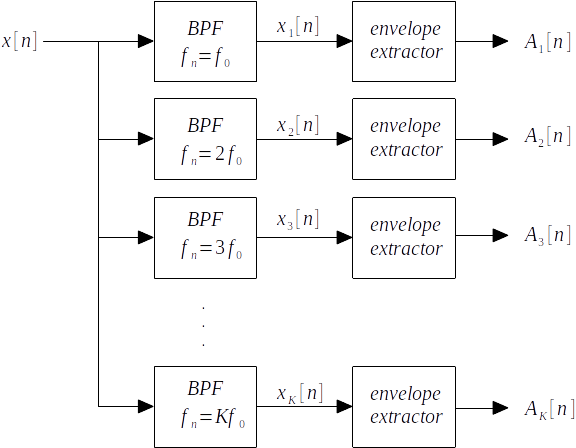

For instance, the following code should extract the envelope of the fundamental frequency component. Change the value of $f_0$ to coincide with your fundamental frequency and check the result. 

In [ ]:
f0 = 296.08
x_1 = bpf(ref, f0, fs)
A_1 = envelope_iir(x_1, r=0.999)
plot_signals([x_1, A_1], fs, t_start=0, t_end=1.5, name=['x_1(t)', 'A_1(t)'])

2.6 Complete the `synthetize_with_bpf` function to implement a synthesis applying different envelopes for each harmonic.


In [ ]:
def synthetize_with_bpf(x, f0, phi, K, fs):
  """Synthetizes an harmonic signal using different envelopes for each harmonic
  The envelops are extracted from the reference signal x.

  Parameters
  ----------
  x : np.array
      The reference signal in the form of a numpy array
  f0: int or float
      Fundamental frequency of the synthesis
  phi : float
      Phase
  K: int
      Number of harmonics
  fs : int or float
      Frequency rate in Hz

  Returns
  -------
  y : np.array
      The output of the filter

  """



  Ts = 1/float(fs)
  t = np.arange(0, len(x)*Ts, Ts)

  y = 0
  for k in range(1, int(K) + 1):
    x_k = bpf(x, f0*k, fs, r=0.995)
    A_k = envelope_iir(x_k, r=0.999)
    y += A_k * np.cos(2*np.pi*k*f0*t + k*phi - (k-1)*np.pi/2)

  y = np.amax(x)*y/np.amax(y) # normalize the output
  return y

2.6 Call the function `synthetize_with_bpf` to get the synthesized signal and **listen to it**.

Note that now you can increase the number of harmonics $K$ as you want because we are not manually measuring the weights of each harmonic.

In [ ]:
f0 = 296.08
dt = 1.004338 - 1.003 #Data from Lab 2
phi = -np.pi*f0*2*dt  #Data from Lab 2
K = 50

bpf_signal = synthetize_with_bpf(ref, f0, phi, K , fs)

In [ ]:
# Original / reference sound:
Audio(np.real(ref), rate=fs)

In [ ]:
# Synthesized signal:
Audio(np.real(bpf_signal), rate=fs)

We consider that both reference and synthesized signals sound similar. Eventhough, the synthesized one sounds **very** artificial. 

2.7 Compare the **spectrograms** of the synthesized signal and reference signal.

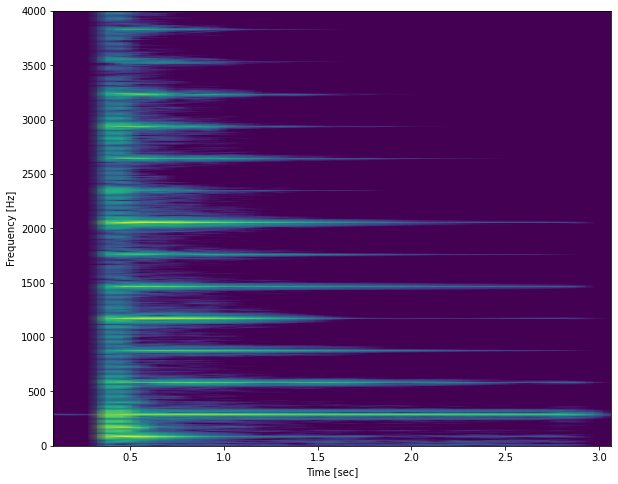

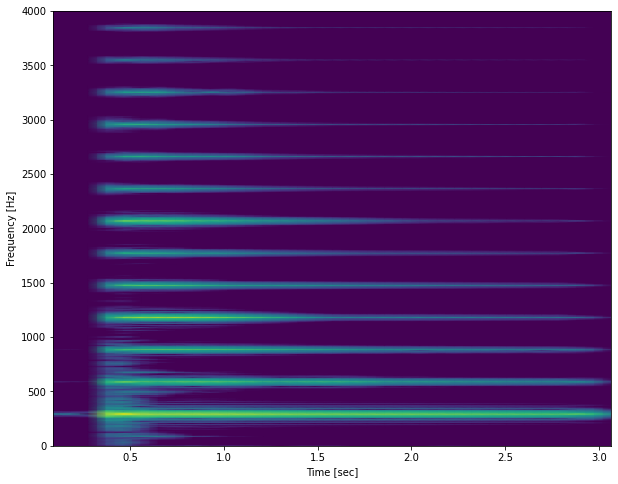

In [ ]:
window_length = 8192
ff, tt, S = signal.spectrogram(ref, fs, nperseg=window_length, noverlap=window_length/2)
# the ref signal is the one we previously loaded

# plot the spectrogram
plt.figure(figsize=(10,8))
plot_spectrogram(ff, tt, S)
plt.ylim([0,4000])
plt.show()

window_length = 8192
ff, tt, S = signal.spectrogram(bpf_signal, fs, nperseg=window_length, noverlap=window_length/2)
# the synth_env signal is the result of multiplying the synthesized signal by the envelope

# plot the spectrogram
plt.figure(figsize=(10,8))
plot_spectrogram(ff, tt, S)
plt.ylim([0,4000])
plt.show()


We observe how the behaviour of the harmonics of the synthesized signal is very similar to the reference one. On the other hand, the rest of the frequencies are mostly ignored, including the first significant one which can be seen in the spectogram of the reference signal. 